In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip drive/MyDrive/abdomen_dataset_npy.zip

Archive:  drive/MyDrive/abdomen_dataset_npy.zip
   creating: source_training_npy/
  inflating: source_training_npy/img0002.npy  
  inflating: source_training_npy/img0003.npy  
  inflating: source_training_npy/img0004.npy  
  inflating: source_training_npy/img0005.npy  
  inflating: source_training_npy/img0006.npy  
  inflating: source_training_npy/img0007.npy  
  inflating: source_training_npy/img0008.npy  
  inflating: source_training_npy/img0010.npy  
  inflating: source_training_npy/img0021.npy  
  inflating: source_training_npy/img0022.npy  
  inflating: source_training_npy/img0023.npy  

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import os
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import ipywidgets as widgets
from ipywidgets import interact, IntSlider, FloatSlider, Dropdown
import plotly.graph_objects as go
import plotly.express as px
from scipy import ndimage
try:
    import nibabel as nib  # For NIfTI file support
    NIBABEL_AVAILABLE = True
except ImportError:
    print("nibabel not installed. Install with: pip install nibabel")
    print("NIfTI file support will not be available.")
    NIBABEL_AVAILABLE = False

In [4]:
def image_picker(min_slice, max_slice, total_slots):
    """
    Returns a list of indices representing equidistant slices between min_slice and max_slice.
    It will try to fill as many slots as possible, up to total_slots.
    """
    if max_slice - min_slice + 1 <= total_slots:
        return list(range(min_slice, max_slice + 1))

    step = (max_slice - min_slice) / (total_slots - 1)
    return [int(min_slice + i * step) for i in range(total_slots)]


def load_volume(filepath):
    """
    Load a 3D medical image volume from various formats.

    Supports:
    - NIfTI files (.nii, .nii.gz)
    - NumPy files (.npy)

    Parameters:
    -----------
    filepath : str
        Path to the volume file

    Returns:
    --------
    numpy.ndarray : 3D volume data
    """
    if not os.path.exists(filepath):
        raise FileNotFoundError(f"File not found: {filepath}")

    # Check file extension
    if filepath.endswith('.npy'):
        # Load NumPy file
        volume = np.load(filepath)
        print(f"✓ Loaded NPY file: {os.path.basename(filepath)}")

    elif filepath.endswith(('.nii', '.nii.gz')):
        # Load NIfTI file
        if not NIBABEL_AVAILABLE:
            raise ImportError("nibabel is required for NIfTI files. Install with: pip install nibabel")

        nifti_img = nib.load(filepath)
        volume = nifti_img.get_fdata()
        print(f"✓ Loaded NIfTI file: {os.path.basename(filepath)}")
        print(f"  NIfTI header info:")
        print(f"    - Affine shape: {nifti_img.affine.shape}")
        print(f"    - Voxel dims: {nifti_img.header.get_zooms()}")

    else:
        raise ValueError(f"Unsupported file format: {filepath}. Supported: .npy, .nii, .nii.gz")

    # Print volume info
    print(f"  Volume shape: {volume.shape}")
    print(f"  Data type: {volume.dtype}")
    print(f"  Value range: [{volume.min():.2f}, {volume.max():.2f}]")

    return volume

In [7]:
def PlotImage(images, filename=None):
    """
    Fixed static grid visualization - works on both MacBook and Colab.
    Includes proper vmin/vmax handling for consistent display across platforms.
    """
    row = 3
    col = 6
    images = np.rot90(images, axes=(0, 1))
    total_slots = row * col
    slices_picker = image_picker(min_slice=0, max_slice=images.shape[2]-1, total_slots=total_slots)

    # Calculate proper display range (fixes MacBook black image issue)
    vmin = np.percentile(images, 1)
    vmax = np.percentile(images, 99)

    plt.figure(figsize=(16, 8))
    for i, idx in enumerate(slices_picker):
        plt.subplot(row, col, i+1)
        # Explicit vmin/vmax ensures consistent display on all platforms
        plt.imshow(images[:,:,idx], cmap='gray', vmin=vmin, vmax=vmax, interpolation='bilinear')
        plt.title(str(idx+1))
        plt.axis('off')
    plt.subplots_adjust(wspace=0.05, hspace=0.2)

    # Save the plot to a file if a filename is provided
    if filename:
        plt.savefig(filename, bbox_inches='tight', dpi=300)

    # Close the figure to free memory
    plt.show()
    plt.close()



 img0003.npy


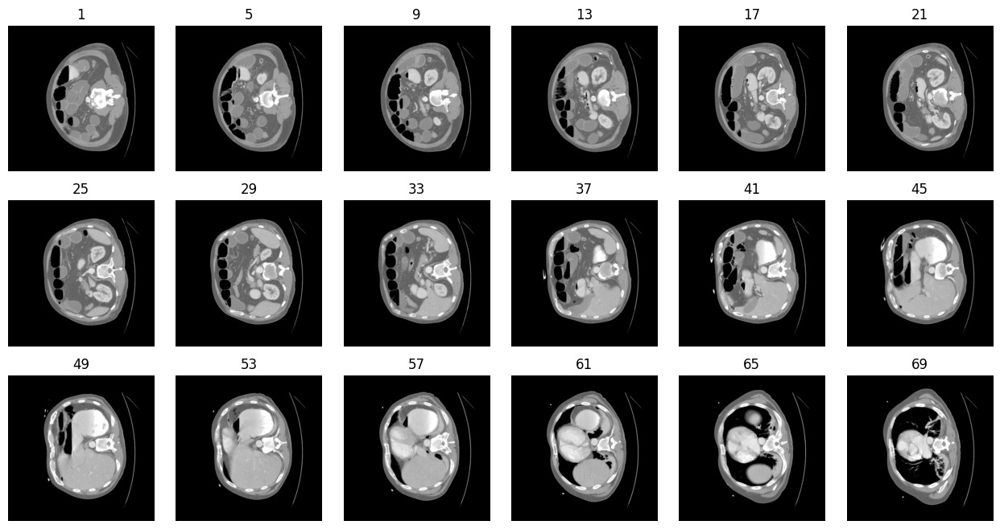


 img0002.npy


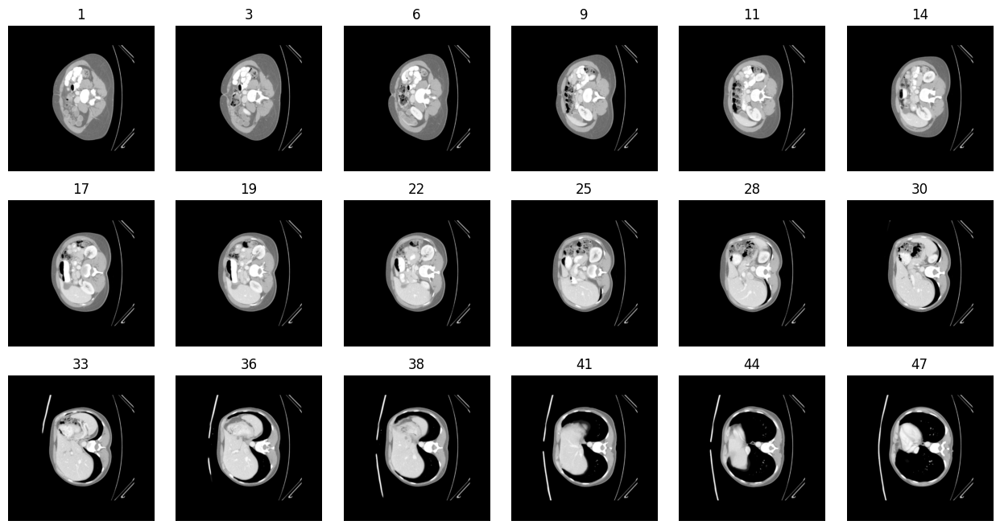

In [8]:
folder_path = 'npy_images'
save_path = 'Visualized_images'

# List all .npy files in the specified directory
npy_files = [f for f in os.listdir(folder_path) if f.endswith('.npy')]

for npy_file in npy_files:
    if 'label' not in npy_file:
        file_path = os.path.join(folder_path, npy_file)

        # Load the volume from the .npy file
        volume = np.load(file_path)

        print('\n', npy_file)
        save_filename = os.path.join(save_path, npy_file.replace('.npy', '.png'))  # Replace '.npy' with '.png'
        PlotImage(volume, filename=save_filename)


In [23]:
# ========================================
# IMPROVED 2D SLICE VISUALIZATION FUNCTIONS
# ========================================

def interactive_slice_viewer(volume, axis=2, title="3D Volume Slice Viewer", cmap='gray'):
    """
    Interactive slice viewer with slider navigation.

    Parameters:
    -----------
    volume : numpy.ndarray
        3D volume data (height, width, depth)
    axis : int
        Axis along which to slice (0, 1, or 2)
    title : str
        Title for the plot
    cmap : str
        Colormap to use
    """
    # Rotate volume for better orientation
    volume_rot = np.rot90(volume, axes=(0, 1))

    # Get dimensions based on slicing axis
    if axis == 2:
        max_slice = volume_rot.shape[2] - 1
        slice_dim_name = "Slice (depth)"
    elif axis == 1:
        max_slice = volume_rot.shape[1] - 1
        slice_dim_name = "Slice (height)"
    else:
        max_slice = volume_rot.shape[0] - 1
        slice_dim_name = "Slice (width)"

    def update_slice(slice_idx):
        plt.figure(figsize=(10, 8))

        if axis == 2:
            img = volume_rot[:, :, slice_idx]
        elif axis == 1:
            img = volume_rot[:, slice_idx, :]
        else:
            img = volume_rot[slice_idx, :, :]

        plt.imshow(img, cmap=cmap, aspect='auto')
        plt.title(f'{title} - {slice_dim_name}: {slice_idx}/{max_slice}')
        plt.colorbar(label='Intensity')
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.tight_layout()
        plt.show()

    # Create interactive slider
    interact(update_slice,
             slice_idx=IntSlider(min=0, max=max_slice, step=1, value=max_slice//2,
                                description=slice_dim_name, continuous_update=False))


def multi_view_interactive(volume, title="Multi-View Slice Viewer", cmap='gray'):
    """
    Interactive viewer showing axial, sagittal, and coronal views simultaneously.

    Parameters:
    -----------
    volume : numpy.ndarray
        3D volume data
    title : str
        Title for the plot
    cmap : str
        Colormap to use
    """
    volume_rot = np.rot90(volume, axes=(0, 1))

    def update_views(slice_x, slice_y, slice_z):
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))

        # Axial view (XY plane)
        axes[0].imshow(volume_rot[:, :, slice_z], cmap=cmap, aspect='auto')
        axes[0].axhline(y=slice_y, color='r', linestyle='--', alpha=0.5)
        axes[0].axvline(x=slice_x, color='g', linestyle='--', alpha=0.5)
        axes[0].set_title(f'Axial View (Z={slice_z})')
        axes[0].set_xlabel('X')
        axes[0].set_ylabel('Y')

        # Coronal view (XZ plane)
        axes[1].imshow(volume_rot[:, slice_y, :], cmap=cmap, aspect='auto')
        axes[1].axhline(y=slice_z, color='b', linestyle='--', alpha=0.5)
        axes[1].axvline(x=slice_x, color='g', linestyle='--', alpha=0.5)
        axes[1].set_title(f'Coronal View (Y={slice_y})')
        axes[1].set_xlabel('X')
        axes[1].set_ylabel('Z')

        # Sagittal view (YZ plane)
        axes[2].imshow(volume_rot[slice_x, :, :], cmap=cmap, aspect='auto')
        axes[2].axhline(y=slice_z, color='b', linestyle='--', alpha=0.5)
        axes[2].axvline(x=slice_y, color='r', linestyle='--', alpha=0.5)
        axes[2].set_title(f'Sagittal View (X={slice_x})')
        axes[2].set_xlabel('Y')
        axes[2].set_ylabel('Z')

        plt.suptitle(title, fontsize=14, fontweight='bold')
        plt.tight_layout()
        plt.show()

    # Create interactive sliders for all three dimensions
    interact(update_views,
             slice_x=IntSlider(min=0, max=volume_rot.shape[0]-1, step=1,
                              value=volume_rot.shape[0]//2, description='X position'),
             slice_y=IntSlider(min=0, max=volume_rot.shape[1]-1, step=1,
                              value=volume_rot.shape[1]//2, description='Y position'),
             slice_z=IntSlider(min=0, max=volume_rot.shape[2]-1, step=1,
                              value=volume_rot.shape[2]//2, description='Z position'))


def create_slice_animation(volume, axis=2, interval=100, cmap='gray', filename=None):
    """
    Create an animated GIF or video of slices through the volume.

    Parameters:
    -----------
    volume : numpy.ndarray
        3D volume data
    axis : int
        Axis along which to slice
    interval : int
        Delay between frames in milliseconds
    cmap : str
        Colormap to use
    filename : str, optional
        If provided, save animation to this file

    Returns:
    --------
    HTML animation object for display in Jupyter
    """
    volume_rot = np.rot90(volume, axes=(0, 1))

    fig, ax = plt.subplots(figsize=(10, 8))

    if axis == 2:
        num_slices = volume_rot.shape[2]
        slice_data = [volume_rot[:, :, i] for i in range(num_slices)]
    elif axis == 1:
        num_slices = volume_rot.shape[1]
        slice_data = [volume_rot[:, i, :] for i in range(num_slices)]
    else:
        num_slices = volume_rot.shape[0]
        slice_data = [volume_rot[i, :, :] for i in range(num_slices)]

    # Initialize with first slice
    im = ax.imshow(slice_data[0], cmap=cmap, animated=True, aspect='auto')
    ax.set_title(f'Slice 0/{num_slices-1}')
    plt.colorbar(im, ax=ax, label='Intensity')

    def update(frame):
        im.set_array(slice_data[frame])
        ax.set_title(f'Slice {frame}/{num_slices-1}')
        return [im]

    anim = FuncAnimation(fig, update, frames=num_slices, interval=interval, blit=True)

    if filename:
        anim.save(filename, writer='pillow', fps=10)
        print(f"Animation saved to {filename}")

    plt.close(fig)
    return HTML(anim.to_jshtml())


In [24]:
# ========================================
# USAGE EXAMPLES - Reading NIfTI and NPY files
# ========================================

# Example 1: Load NIfTI file - Example 1: Loading NIfTI file
sample_nifti = 'drive/MyDrive/img0066.nii.gz'  # Write your NIfTI file path here
sample_npy = os.path.join('npy_images', 'img0002.npy')  # Or npy file path

# Choose which file to load - Choose which file to read:
sample_file = sample_nifti  # For NIfTI - uncomment this for NIfTI
# sample_file = sample_npy  # For NPY - uncomment this for NPY

if os.path.exists(sample_file):
    # Use the load_volume function - supports both NIfTI and NPY
    # Use load_volume function - supports both NIfTI and NPY formats
    volume = load_volume(sample_file)
    print(f"\n✓ Ready to visualize! Now you can visualize the image")
else:
    print(f"⚠️  Sample file not found: {sample_file}")
    print("Please update the path to your file:")
    print("  - For NIfTI: 'path/to/scan.nii' or 'path/to/scan.nii.gz'")
    print("  - For NPY: 'path/to/volume.npy'")
    print("\nPlease update your file path:")
    print("  - For NIfTI: path to .nii or .nii.gz file")
    print("  - For NPY: path to .npy file")


✓ Loaded NIfTI file: img0066.nii.gz
  NIfTI header info:
    - Affine shape: (4, 4)
    - Voxel dims: (np.float32(0.8378906), np.float32(0.8378906), np.float32(3.0))
  Volume shape: (512, 512, 171)
  Data type: float64
  Value range: [-1024.00, 1427.00]

✓ Ready to visualize! Now you can visualize the image


## Example 1: Interactive Slice Viewer with Slider
Use the slider to navigate through slices interactively.


In [16]:
# Interactive slice viewer
if 'volume' in locals():
    interactive_slice_viewer(volume, axis=2, title="CT Scan - Interactive Viewer", cmap='gray')


interactive(children=(IntSlider(value=85, continuous_update=False, description='Slice (depth)', max=170), Outp…

## Example 2: Multi-View Interactive Viewer
Shows axial, coronal, and sagittal views simultaneously with crosshairs.


In [25]:
# Multi-view interactive viewer
if 'volume' in locals():
    multi_view_interactive(volume, title="CT Scan - Multi-View", cmap='gray')


interactive(children=(IntSlider(value=256, description='X position', max=511), IntSlider(value=256, descriptio…

## Example 3: Animated Slice Viewer
Creates an HTML5 animation that plays through all slices.


In [26]:
# Animated slice viewer
if 'volume' in locals():
    anim = create_slice_animation(volume, axis=2, interval=100, cmap='gray')
    # To save as GIF:
    # anim = create_slice_animation(volume, axis=2, interval=100, cmap='gray', filename='volume_animation.gif')
    display(anim)
